In [24]:
all = [var for var in globals() if var[0] != '_']
for var in all:
    del var
del all

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import time, datetime, sys, os
from module_opt import *

In [26]:
# Parameter setting
g = 9.81 # Gravity acceleration [m*s2]
c = 343 # Sound speed [m/s]
e = .8 # Oswald efficiency factor
C_D0 = .0083 # Zero lift drage coefficient
AR = 10 # Aspect ratio of the wing
S = 100 # Platform area [m2]
W_e = 162400 # Empty weight of the aircraft [kg]
W_fuel = 146571 # Initial fuel weigh of the aricraft [kg]
A_t = 1.3295 # Surface area of the turbine [m2]
FAR = .1 # Fuel ratio over the air

fuel_remain = .25 # Fuel remaining level after flight

In [27]:
### Design variables
# # One value
# h = 10000 # Altitude [m]
# V = 150 # Cruise Velocity [m/s]

# Ranged values
resolution = .1
step_V = 50*resolution
step_h = 5000*resolution
V_limit = 600 # [m/s]
h_limit = 35000 # [m]
grid = np.meshgrid(np.arange(0.01, V_limit+step_V, step_V), np.arange(0.01, h_limit+step_h, step_h))
grid

V = grid[0].copy()
h = grid[1].copy()

# 범위 제한 안 걸면 계산 에러(경고) 뜨는 것들 생긴다. 특히 고도가 0 이하로 내려가거나 너무 높으면 공기밀도(rho_air) 계산 시 에러 발생
# 속도도 0 이하로 걸어버리면 계산 에러(경고) 발생
V[np.where(V < 1)] = 1
V[np.where(V > 400)] = 400
h[np.where(h < 1)] = 1
h[np.where(h > 25000)] = 25000

In [28]:
# Intermediate variables
rho_air = 1.2*(1 - .0065*h/288)**5.26 # Air density [kg/m3]
W_f = W_e + (W_fuel*fuel_remain) # Weight of the aircraft after flight [kg]
L = W_f*g # Lift force [N]
C_L = 2*L/(rho_air*(V**2)*S) # Lift Coefficient
C_WD = 10*(np.arctan(10*((V/(.7*c))**2 - 1)) + .5*np.pi) # Wave drag coefficient
# C_WD = 0.06*np.maximum(0.0, (V/c)-0.72)**2
C_D = C_D0 + (C_L**2)/(np.pi*e*AR) + C_WD # Drag coefficient
D = .5*C_D*rho_air*(V**2)*S # Drag force [N]
T = D # Thrust force = Drag force [N]
W_i = W_e + W_fuel # Initial weight of the aircraft [kg]
m_air = V*A_t*rho_air # Mass rate of air [kg/s]
m_f = m_air*FAR # Mass rate of fuel [kg/s]
c_t = m_f/T + 1e-5 # Specific fuel consumption [kg/(s*N)]

In [29]:
Range = (V/c_t)*(C_L/C_D)*np.log(W_i/W_f) # Maximum range of aircraft from Breguet Eqn [m]
Range = np.round(Range*.001)

Text(0.5, 1.0, 'Maximum range of aircraft vs Velocity, Altitude')

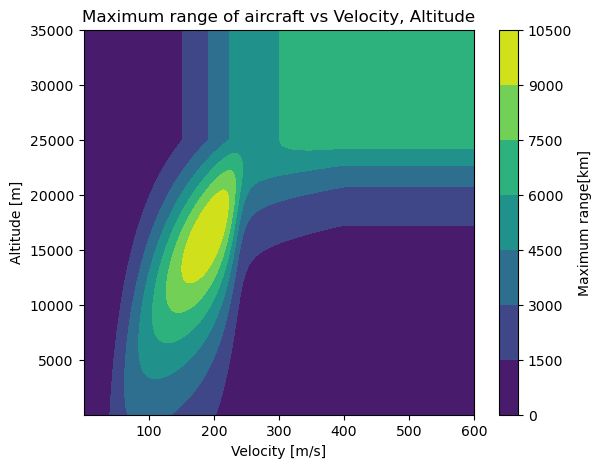

In [30]:
fig, ax = plt.subplots(1, 1, figsize=(6.3, 5))
contourf = ax.contourf(grid[0], grid[1], Range)
colorbar = fig.colorbar(contourf, ax=ax)
colorbar.set_label('Maximum range[km]')
ax.set_xlabel('Velocity [m/s]')
ax.set_ylabel('Altitude [m]')
ax.set_title('Maximum range of aircraft vs Velocity, Altitude')

# V(운항속도)가 커질수록 발산. 식의 특성상 그런 듯. 따라서 optimization 돌릴 때 V(운항속도)의 범위를 제한지어야 함.
# unconstrained optimization method를 쓰려면 목적함수 자체에다가 h(고도), V(운항속도)의 범위를 제한거는 조치를 취해야 함.

In [31]:
def range_breguet(x):
    
    V = x[0]
    h = x[1]
    
    if any(isinstance(element, (list, np.ndarray)) for element in x): # x가 리스트나 ndarray를 원소로 가진 tuple이면 배열 전체에 상/하한 제한
        V[np.where(V < .1)] = .1
        V[np.where(V > 400)] = 400
        h[np.where(h < .1)] = .1
        h[np.where(h > 25000)] = 25000
    else: # x가 그냥 ndarray이면 그냥 각 원소에 상/하한 제한
        if V < 1:
            V = 1
        elif V > 400:
            V = 400
        
        if h < 1:
            h = 1
        elif h > 25000:
            h = 25000

    # Parameter setting
    g = 9.81 # Gravity acceleration [m*s2]
    c = 343 # Sound speed [m/s]
    e = .8 # Oswald efficiency factor
    C_D0 = .0083 # Zero lift drage coefficient
    AR = 10 # Aspect ratio of the wing
    S = 100 # Platform area [m2]
    W_e = 162400 # Empty weight of the aircraft [kg]
    W_fuel = 146571 # Initial fuel weigh of the aricraft [kg]
    A_t = 1.3295 # Surface area of the turbine [m2]
    FAR = .1 # Fuel ratio over the air

    fuel_remain = .25 # Fuel remaining level after flight

    # Intermediate variables
    rho_air = 1.2*(1 - .0065*h/288)**5.26 # Air density [kg/m3]
    W_f = W_e + (W_fuel*fuel_remain) # Weight of the aircraft after flight [kg]
    L = W_f*g # Lift force [N]
    C_L = 2*L/(rho_air*(V**2)*S) # Lift Coefficient
    C_WD = 10*(np.arctan(10*((V/(.7*c))**2 - 1)) + .5*np.pi) # Wave drag coefficient
    # C_WD = 0.06*np.maximum(0.0, (V/c)-0.72)**2
    C_D = C_D0 + (C_L**2)/(np.pi*e*AR) + C_WD # Drag coefficient
    D = .5*C_D*rho_air*(V**2)*S # Drag force [N]
    T = D # Thrust force = Drag force [N]
    W_i = W_e + W_fuel # Initial weight of the aircraft [kg]
    m_air = V*A_t*rho_air # Mass rate of air [kg/s]
    m_f = m_air*FAR # Mass rate of fuel [kg/s]
    c_t = m_f/T + 1e-5 # Specific fuel consumption [kg/(s*N)]

    # Range
    result = (V/c_t)*(C_L/C_D)*np.log(W_i/W_f) # Maximum range of aircraft from Breguet Eqn [m]
    # Range = np.round(Range*.001)

    return result

In [32]:
func = lambda x : -1 * range_breguet(x) # max f 가 목표이기 때문에 -1 곱한 걸 obj function으로 정의
# x_cur = [100, 5000]
x_cur = np.array([50, 5000])
# stp_descent(f=func, x0=x_cur, tol=1e-2) # Optimization converges -> Iteration : 172984 / x* : [  193.27971707 14856.71970818] / f(x*) : -3001469.4457891597 / norm(grad(x*)) : 0.00996276493437222 ; 5m 27.8s
# cg_hs(f=func, x0=x_cur, tol=1e-2) # Optimization converges -> Iteration : 52 / x* : [  193.27943705 14856.67099614] / f(x*) : -3001469.445567526 / norm(grad(x*)) : 0.0067151643117514155 ; 0.1s
# cg_fr(f=func, x0=x_cur, tol=1e-2) # Optimization converges -> Iteration : 30 / x* : [  193.28005388 14856.77611601] / f(x*) : -3001469.445908484 / norm(grad(x*)) : 0.006821815126508694 ; 0.1s
# newton(f=func, x0=x_cur, tol=1e-2) # Optimization converges -> Iteration : 360 / x* : [  193.27912936 14856.61898624] / f(x*) : -3001469.4452094897 / norm(grad(x*)) : 0.009622682166359092 ; 0.3s
# quasi_newton_bfgs(f=func, x0=x_cur, tol=1e-2) # Optimization converges -> Iteration : 14 / x* : [  193.28016227 14856.79353935] / f(x*) : -3001469.445915551 / norm(grad(x*)) : 0.0001216789560812844 ; 0.0s

In [33]:
func = lambda x : -1 * range_breguet(x) # max f 가 목표이기 때문에 -1 곱한 걸 obj function으로 정의
# x_cur = [100, 5000]
x_cur = np.array([50, 5000])
list_x_stp, list_f_stp, list_grad_stp = stp_descent(f=func, x0=x_cur, tol=1e-2) # Optimization converges -> Iteration : 172984 / x* : [  193.27971707 14856.71970818] / f(x*) : -3001469.4457891597 / norm(grad(x*)) : 0.00996276493437222 ; 5m 27.8s
list_x_bfgs, list_f_bfgs, list_grad_bfgs = quasi_newton_bfgs(f=func, x0=x_cur, tol=1e-2) # Optimization converges -> Iteration : 14 / x* : [  193.28016227 14856.79353935] / f(x*) : -3001469.445915551 / norm(grad(x*)) : 0.0001216789560812844 ; 0.0s

Since |grad(x0)| = 83029.74862123383 > 0.01, x0 : [  50 5000] is not an optimum point. Optimization begins !
x_1 : [ 168.83843925 4999.80282518]
f_1 : -4278367.229010063
norm(grad(x_1)) : 35009.78997341896
recent alpha : 0.0014312774011847635
recent p : [83029.63433554  -137.76142835]

x_2 : [ 118.89804618 5000.53931537]
f_2 : -5248673.216002639
norm(grad(x_2)) : 751.989281719974
recent alpha : 0.001426624480366409
recent p : [-35005.98353603    516.24670282]

x_3 : [ 120.56537674 5001.82797693]
f_3 : -5248785.950351593
norm(grad(x_3)) : 1258.7531808716144
recent alpha : 0.002802277398424546
recent p : [594.99125873 459.86224226]

x_4 : [ 118.40492677 5002.6970429 ]
f_4 : -5249233.547603477
norm(grad(x_4)) : 1232.2940644291627
recent alpha : 0.0018500011652415201
recent p : [-1167.81005733   469.76509061]

x_5 : [ 120.61928668 5003.58084337]
f_5 : -5249545.459135564
norm(grad(x_5)) : 1301.7980989644936
recent alpha : 0.0019347796638691439
recent p : [1144.50236693  456.79644625]

x_6 :

In [34]:
list_x_stp = np.array(list_x_stp)
list_f_stp = np.array(list_f_stp)
list_grad_stp = np.array(list_grad_stp)
list_x_bfgs = np.array(list_x_bfgs)
list_f_bfgs = np.array(list_f_bfgs)
list_grad_bfgs = np.array(list_grad_bfgs)

In [35]:
list_grad_stp_norm = (list_grad_stp[:, 0]**2 + list_grad_stp[:, 1]**2)**.5
list_grad_bfgs_norm = (list_grad_bfgs[:, 0]**2 + list_grad_bfgs[:, 1]**2)**.5

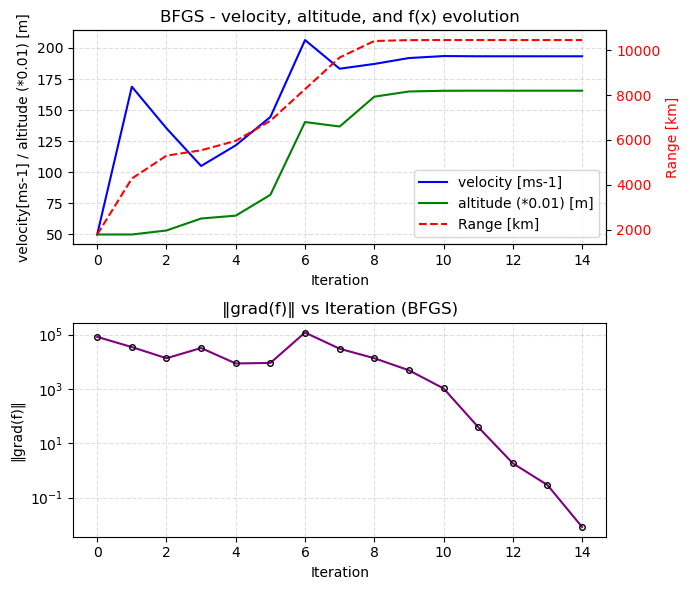

In [36]:
# BFGS 결과 시각화
# ---------------------------------------------------------------
fig, ax1 = plt.subplots(2, 1, figsize=(7, 6))
ax1[0].set_title("BFGS - velocity, altitude, and f(x) evolution")

iters_bfgs = np.arange(len(list_f_bfgs))

# ===== 왼쪽 y축: velocity, altitude =====
ax1_left = ax1[0]
ax1_left.plot(iters_bfgs, [x[0] for x in list_x_bfgs], label='velocity [ms-1]', color='blue')
ax1_left.plot(iters_bfgs, [x[1]*0.01 for x in list_x_bfgs], label='altitude (*0.01) [m]', color='green')
ax1_left.set_xlabel("Iteration")
ax1_left.set_ylabel("velocity[ms-1] / altitude (*0.01) [m]", color='black')
ax1_left.tick_params(axis='y', labelcolor='black')

# ===== 오른쪽 y축: f(x) =====
ax1_right = ax1_left.twinx()
ax1_right.plot(iters_bfgs, -np.array(list_f_bfgs)*0.001, label='Range [km]', color='red', linestyle='--')
ax1_right.set_ylabel("Range [km]", color='red')
ax1_right.tick_params(axis='y', labelcolor='red')

# ===== 범례 병합 =====
lines_left, labels_left = ax1_left.get_legend_handles_labels()
lines_right, labels_right = ax1_right.get_legend_handles_labels()
ax1_left.legend(lines_left + lines_right, labels_left + labels_right, loc='best')

ax1_left.grid(True, linestyle='--', alpha=0.4)

# ===== 아래 subplot: grad norm =====
ax1[1].set_title("‖grad(f)‖ vs Iteration (BFGS)")
ax1[1].plot(iters_bfgs, list_grad_bfgs_norm,
            color='purple', marker='o', markersize=4,
            markerfacecolor='none', markeredgecolor='black')
ax1[1].set_xlabel("Iteration")
ax1[1].set_ylabel("‖grad(f)‖")
ax1[1].set_yscale("log")
ax1[1].grid(True, linestyle='--', alpha=0.4)

plt.tight_layout()
plt.show()


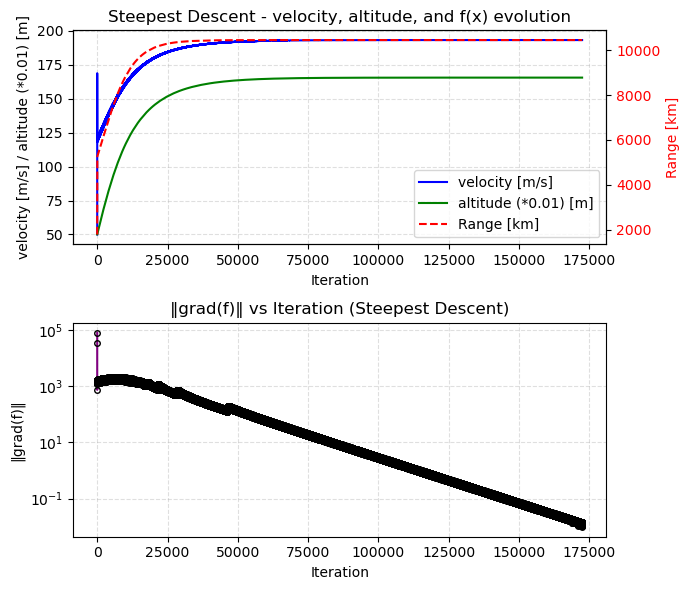

In [37]:
# Steepest Descent 결과 시각화
# ---------------------------------------------------------------
fig, ax1 = plt.subplots(2, 1, figsize=(7, 6))
ax1[0].set_title("Steepest Descent - velocity, altitude, and f(x) evolution")

iters_stp = np.arange(len(list_f_stp))

# ===== 왼쪽 y축: velocity, altitude =====
ax1_left = ax1[0]
ax1_left.plot(iters_stp, [x[0] for x in list_x_stp], label='velocity [m/s]', color='blue')
ax1_left.plot(iters_stp, [x[1]*0.01 for x in list_x_stp], label='altitude (*0.01) [m]', color='green')
ax1_left.set_xlabel("Iteration")
ax1_left.set_ylabel("velocity [m/s] / altitude (*0.01) [m]", color='black')
ax1_left.tick_params(axis='y', labelcolor='black')

# ===== 오른쪽 y축: f(x) =====
ax1_right = ax1_left.twinx()
ax1_right.plot(iters_stp, -np.array(list_f_stp)*0.001, label='Range [km]', color='red', linestyle='--')
ax1_right.set_ylabel("Range [km]", color='red')
ax1_right.tick_params(axis='y', labelcolor='red')

# ===== 범례 병합 =====
lines_left, labels_left = ax1_left.get_legend_handles_labels()
lines_right, labels_right = ax1_right.get_legend_handles_labels()
ax1_left.legend(lines_left + lines_right, labels_left + labels_right, loc='best')

ax1_left.grid(True, linestyle='--', alpha=0.4)

# ===== 아래 subplot: grad norm =====
ax1[1].set_title("‖grad(f)‖ vs Iteration (Steepest Descent)")
ax1[1].plot(iters_stp, list_grad_stp_norm,
            color='purple', marker='o', markersize=4,
            markerfacecolor='none', markeredgecolor='black')
ax1[1].set_xlabel("Iteration")
ax1[1].set_ylabel("‖grad(f)‖")
ax1[1].set_yscale("log")
ax1[1].grid(True, linestyle='--', alpha=0.4)

plt.tight_layout()
plt.show()
